In [7]:
import typing
import io
import os

import torch
import numpy as np
import cv2
import matplotlib.pyplot as plt

from urllib.request import urlretrieve

from PIL import Image
from torchvision import transforms

from models.modeling_seg import ActiveTestVisionTransformer, CONFIGS

from utils.data_utils_feature import FeatureDataset

def np_read(file):
    with open(file, "rb") as outfile:
        data = np.load(outfile)
    return data

In [8]:
config = CONFIGS["ViT-B_16"]
config.input_feature_dim = 25
model = ActiveTestVisionTransformer(config, num_classes=50, zero_head=False, img_size=480, vis=True)
model_checkpoint = "./output/ViT-output-PSPNet-VOC-train-ordinal_checkpoint.bin"
model.load_state_dict(torch.load(model_checkpoint))
model.eval()

ActiveTestVisionTransformer(
  (transformer): Transformer(
    (embeddings): Embeddings(
      (patch_embeddings): Conv2d(25, 768, kernel_size=(16, 16), stride=(16, 16))
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (encoder): Encoder(
      (layer): ModuleList(
        (0): Block(
          (attention_norm): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
          (ffn_norm): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
          (ffn): Mlp(
            (fc1): Linear(in_features=768, out_features=3072, bias=True)
            (fc2): Linear(in_features=3072, out_features=768, bias=True)
            (dropout): Dropout(p=0.1, inplace=False)
          )
          (attn): Attention(
            (query): Linear(in_features=768, out_features=768, bias=True)
            (key): Linear(in_features=768, out_features=768, bias=True)
            (value): Linear(in_features=768, out_features=768, bias=True)
            (out): Linear(in_features=768, out_features=768, bias=

In [15]:
## choose one data
import torch.nn.functional as F
def np_read_with_tensor_output(file):
    with open(file, "rb") as outfile:
        data = np.load(outfile)
    return torch.from_numpy(data.astype(np.float32))

split = "train"
model_data_path = "/workspace/pytorch-segmentation/pro_data/PSPNet_VOC/"
feature_dir = model_data_path + split + "/output/"
image_dir = model_data_path + split + "/image/"
loss_dir = model_data_path + split + "/loss/"
annotation_dir = model_data_path + split + "/image_true_losses.npy"
inputs_path = model_data_path + split

train_loader = FeatureDataset(inputs_path, annotation_dir)

def attention_display(index, image_name):
    file_name = str(index//8) + ".npy"
    # one_result = np_read_with_tensor_output(feature_dir + file_name)
    # one_image = np_read_with_tensor_output(image_dir + file_name)
    image_index = index % 8
    # feature = one_result[image_index]
    # image = one_image[image_index]
    # feature = F.softmax(feature, dim=0)
    # feature[feature>0.99] = 1
    # feature[feature<0.01] = 0
    # feature_entropy = torch.sum(-feature * torch.log(feature + 1e-20), dim=0)
    # feature = torch.cat((image, feature), dim=0)
    feature, label = train_loader.__getitem__(index)
    logits, att_mat = model(feature.unsqueeze(0))
    
    losses = np_read(loss_dir + file_name)[image_index]
    plt.matshow(losses)
    plt.colorbar()
    plt.show()
    
    att_mat = torch.stack(att_mat).squeeze(1)

    # Average the attention weights across all heads.
    att_mat = torch.mean(att_mat, dim=1)

    # To account for residual connections, we add an identity matrix to the
    # attention matrix and re-normalize the weights.
    residual_att = torch.eye(att_mat.size(1))
    aug_att_mat = att_mat + residual_att
    aug_att_mat = aug_att_mat / aug_att_mat.sum(dim=-1).unsqueeze(-1)

    # Recursively multiply the weight matrices
    joint_attentions = torch.zeros(aug_att_mat.size())
    joint_attentions[0] = aug_att_mat[0]

    for n in range(1, aug_att_mat.size(0)):
        joint_attentions[n] = torch.matmul(aug_att_mat[n], joint_attentions[n-1])

    # Attention from the output token to the input space.
    v = joint_attentions[-1]
    grid_size = int(np.sqrt(aug_att_mat.size(-1)))
    mask = v[0, 1:].reshape(grid_size, grid_size).detach().numpy()

    # transform = transforms.Compose([
    #     transforms.Resize((224, 224)),
    #     transforms.ToTensor(),
    #     transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5]),
    # ])
    im = Image.open("/workspace/datasets/PascalVOC/VOCdevkit/VOC2012/JPEGImages/" + image_name)
    # x = transform(im)
    new_mask = cv2.resize(mask / mask.max(), im.size)[..., np.newaxis]
    result = (new_mask * im).astype("uint8")
    fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(16, 16))

    ax1.set_title('Original')
    ax2.set_title('Attention Map')
    _ = ax1.imshow(im)
    _ = ax2.imshow(result)

    probs = torch.nn.Softmax(dim=-1)(logits)
    top5 = torch.argsort(probs, dim=-1, descending=True)
    print("Prediction Label and Attention Map!\n")

    for i, v in enumerate(joint_attentions):
        # Attention from the output token to the input space.
        mask = v[0, 1:].reshape(grid_size, grid_size).detach().numpy()
        new_mask = cv2.resize(mask / mask.max(), im.size)[..., np.newaxis]
        result = (new_mask * im).astype("uint8")

        fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(16, 16))
        ax1.set_title('Original')
        ax2.set_title('Attention Map_%d Layer' % (i+1))
        _ = ax1.imshow(im)
        _ = ax2.imshow(result)

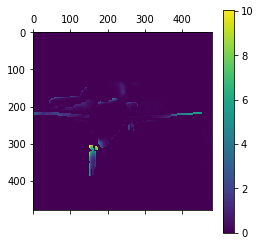

Prediction Label and Attention Map!



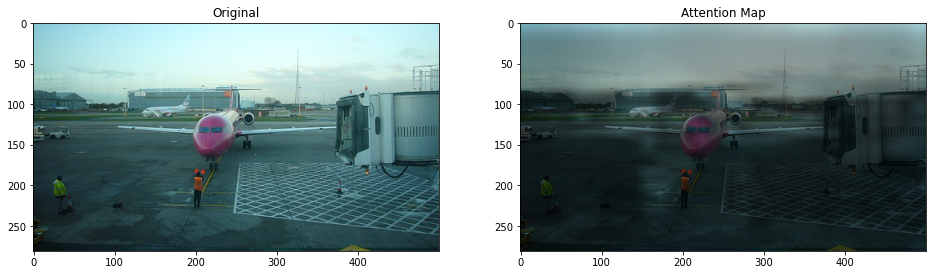

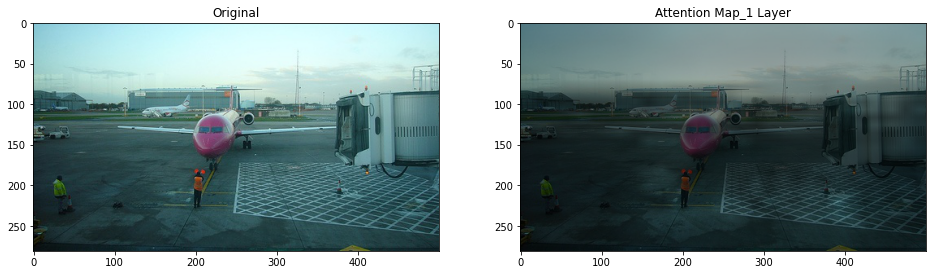

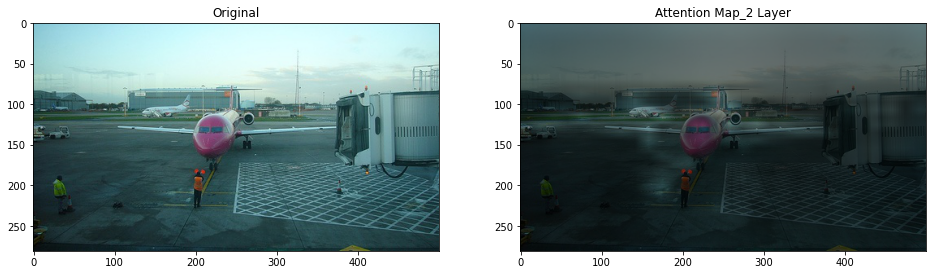

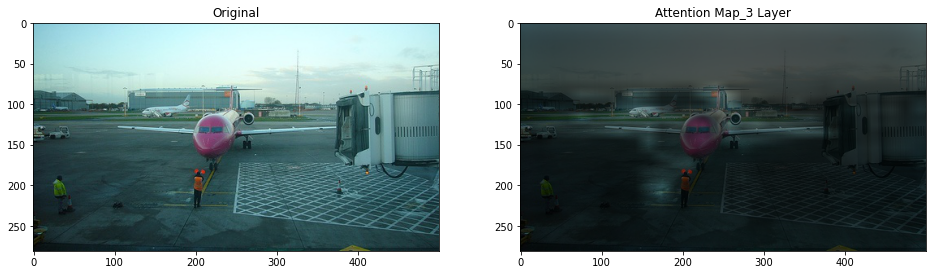

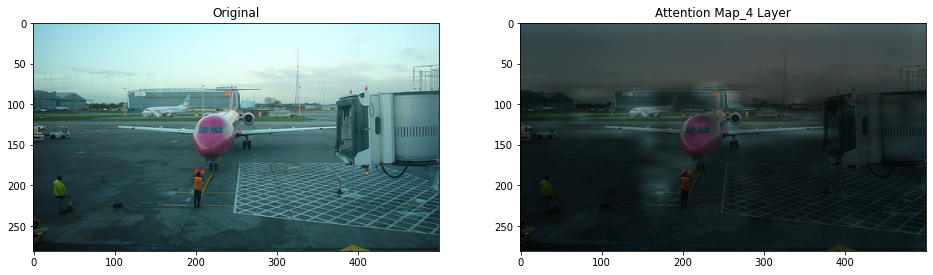

...

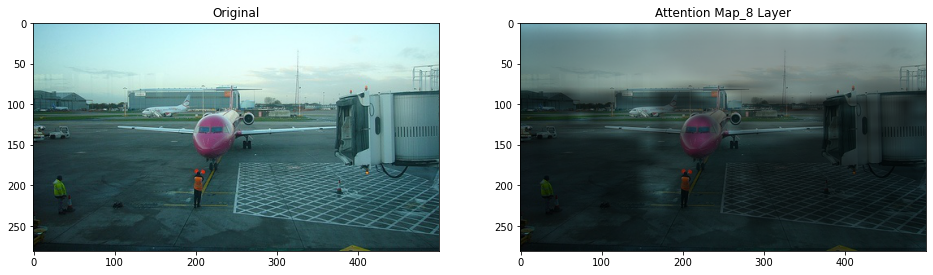

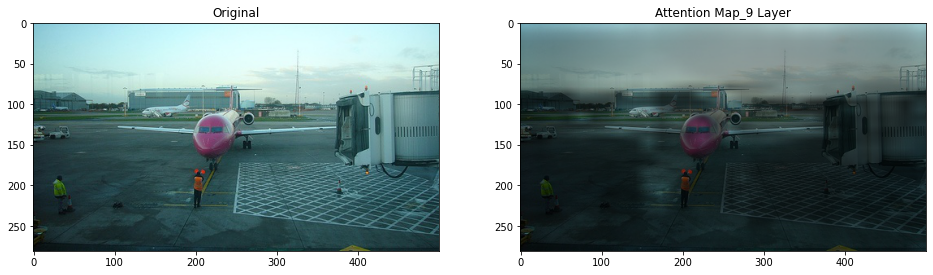

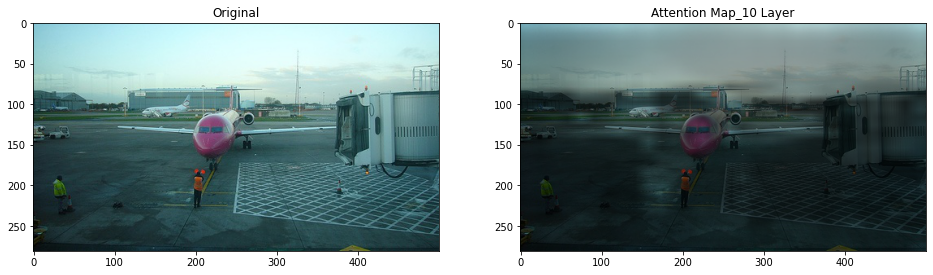

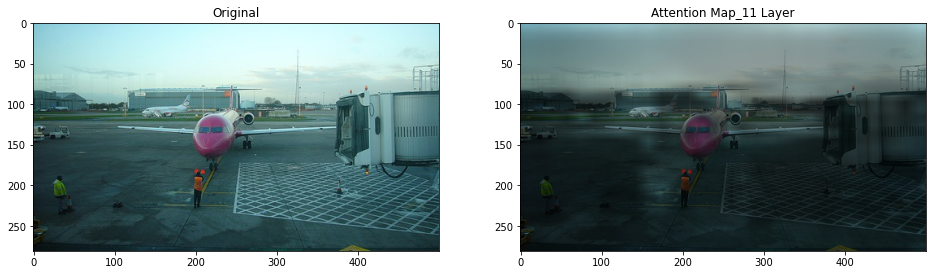

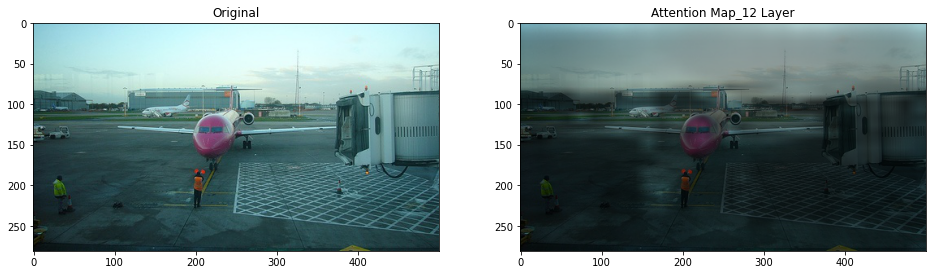

In [16]:
attention_display(0, "2007_000032.jpg")

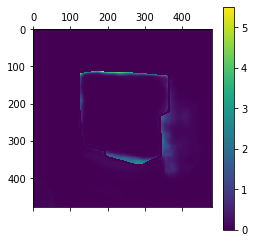

Prediction Label and Attention Map!



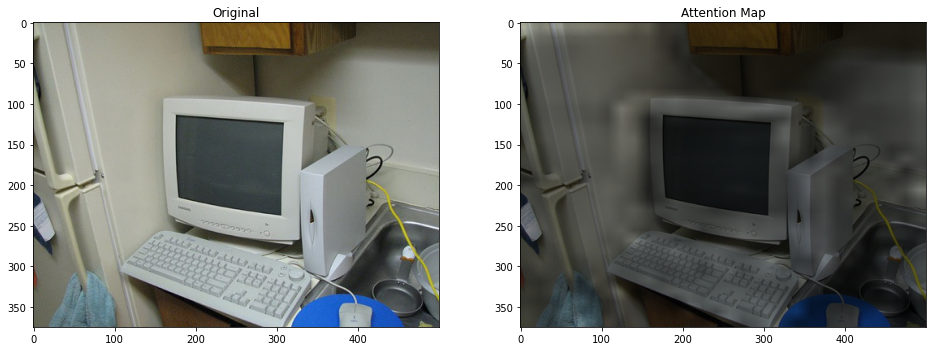

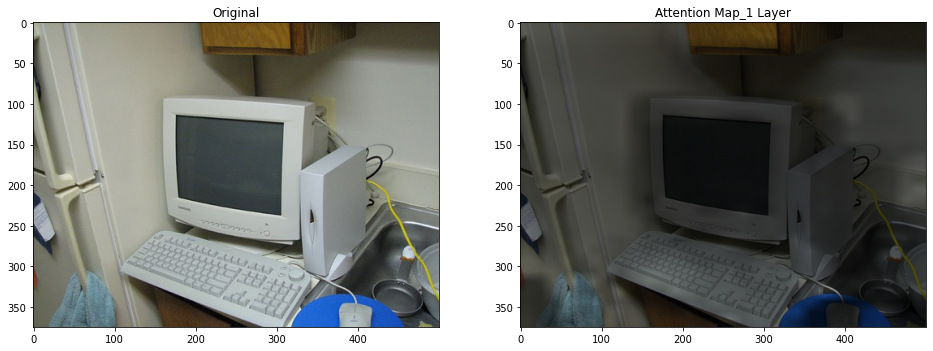

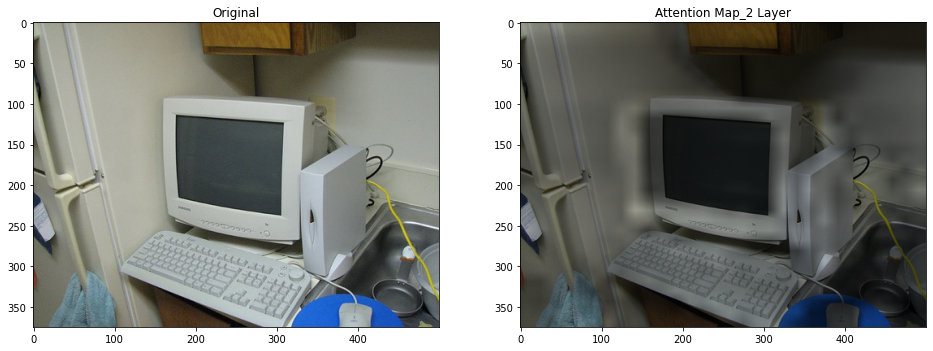

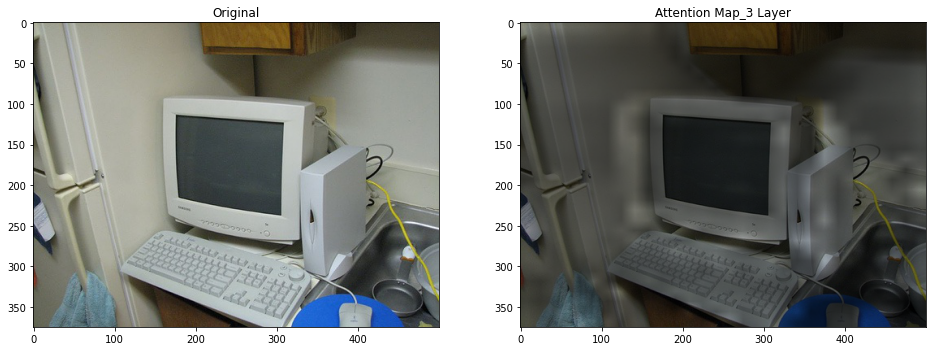

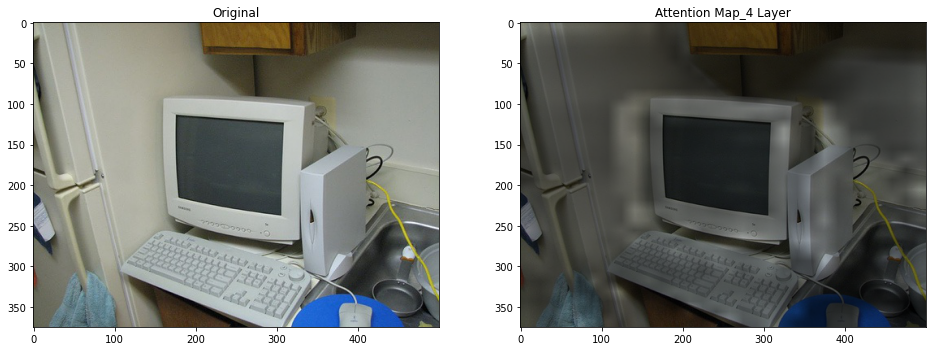

...

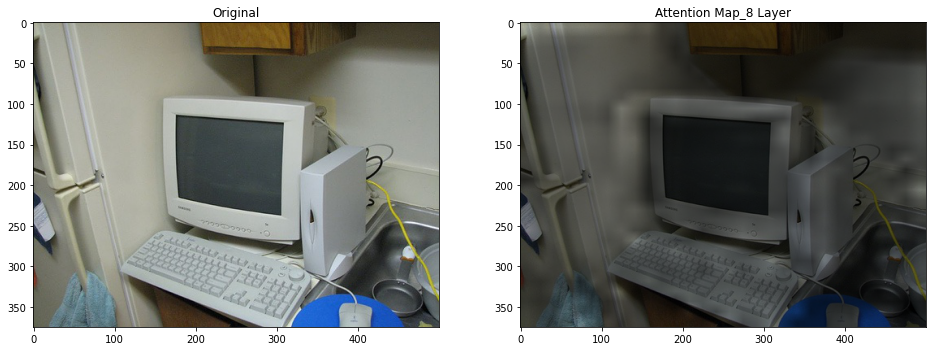

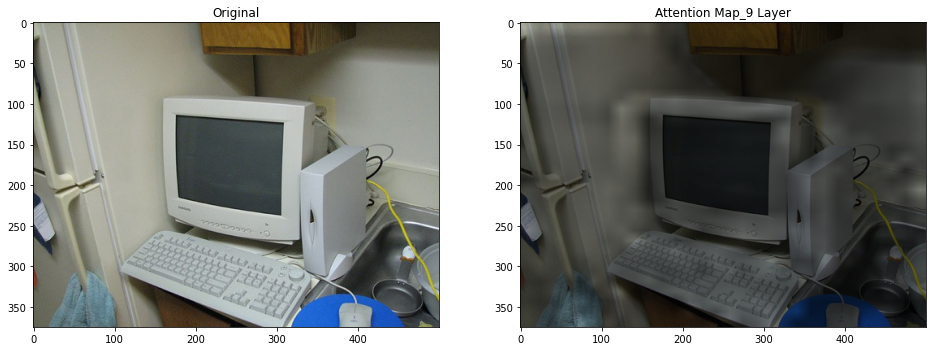

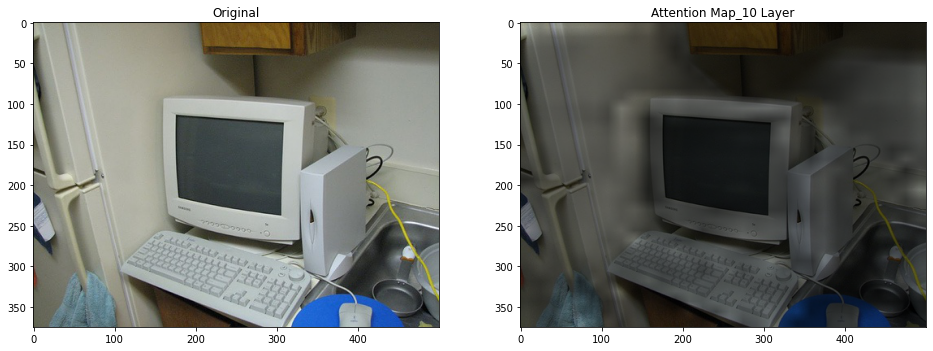

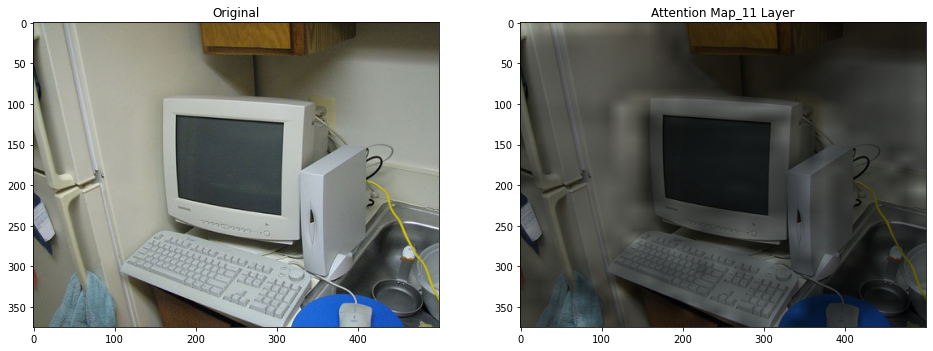

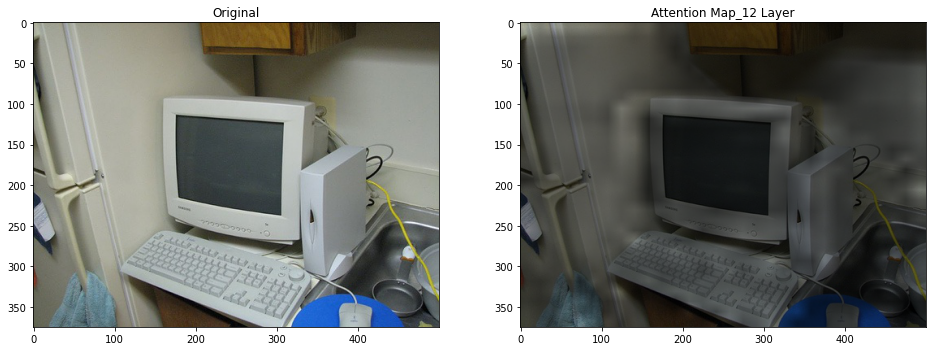

In [17]:
attention_display(1, "2007_000039.jpg")

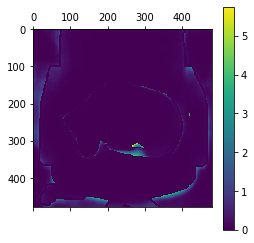

Prediction Label and Attention Map!



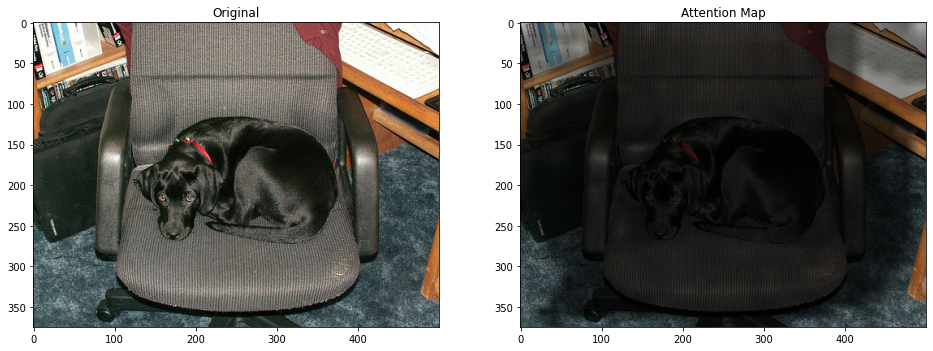

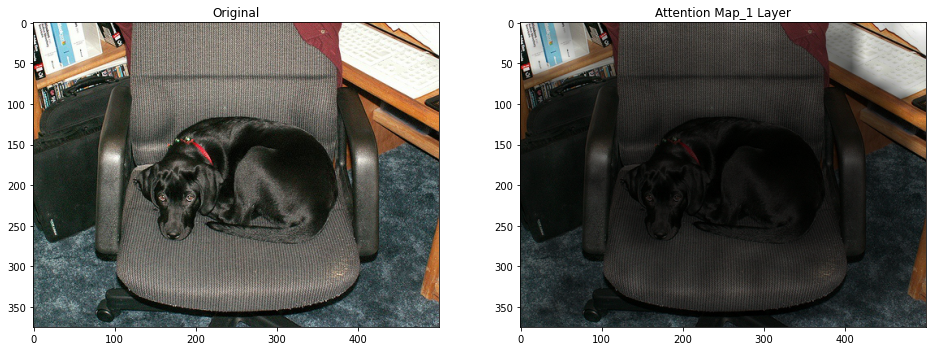

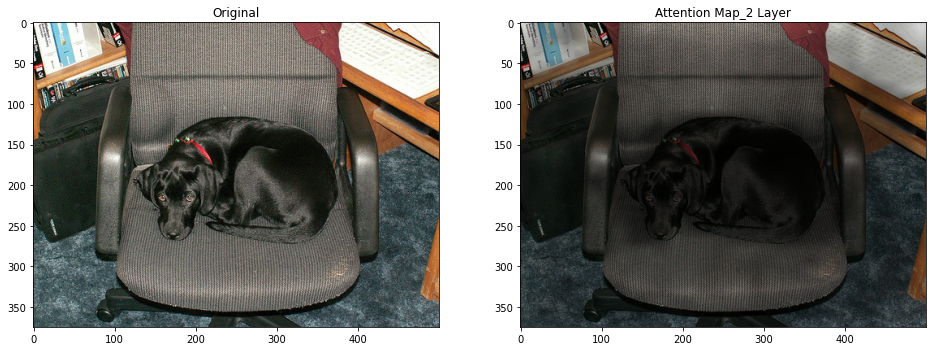

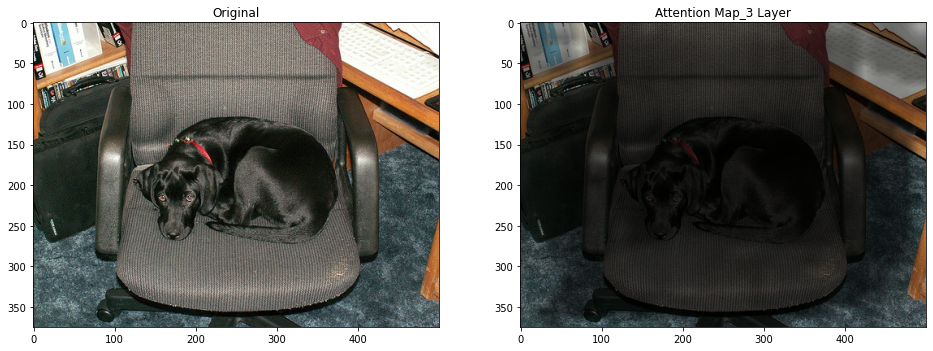

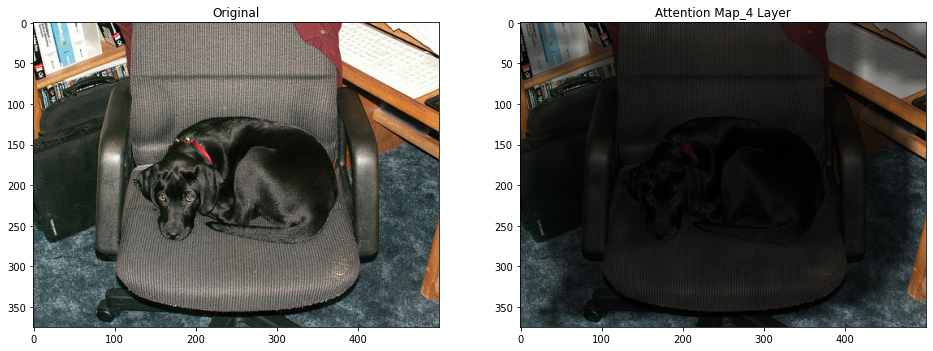

...

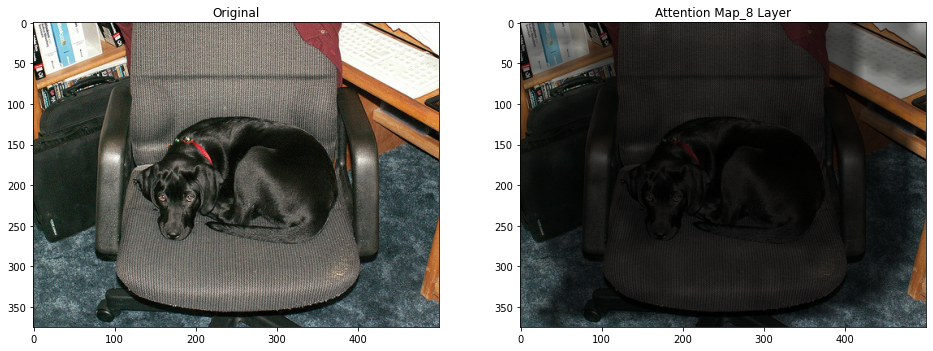

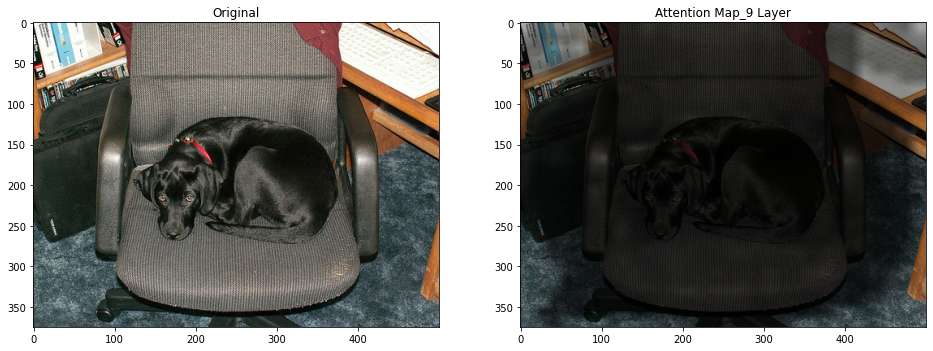

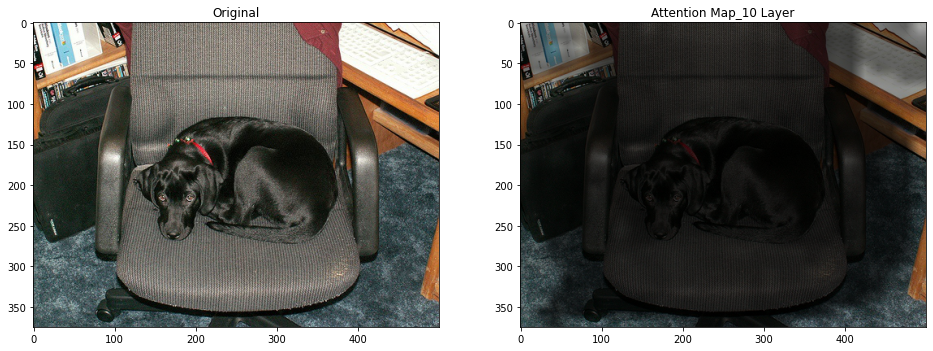

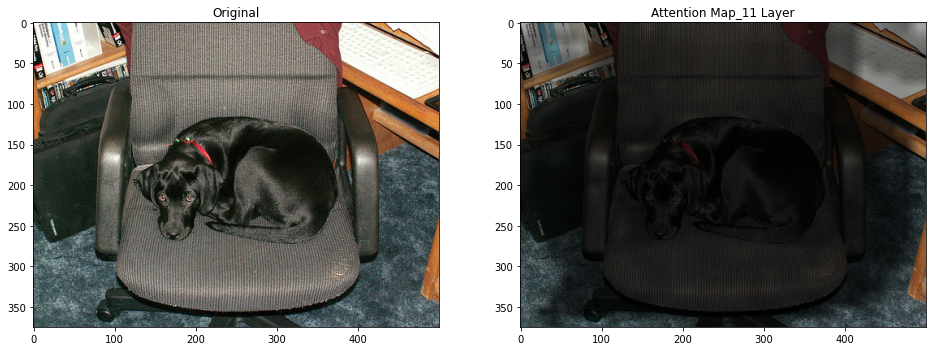

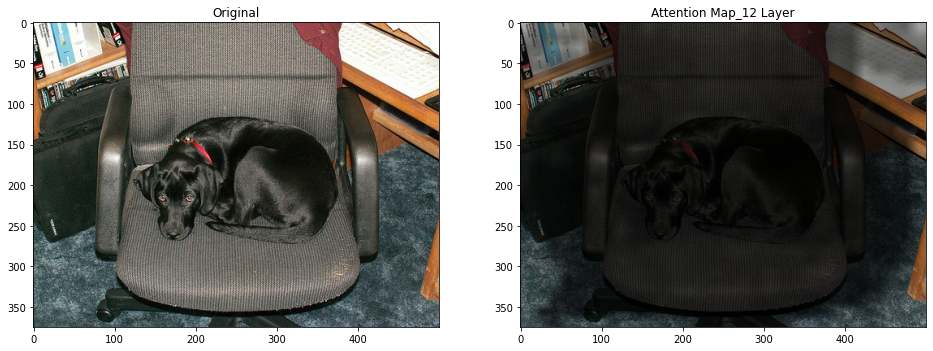

In [6]:
attention_display(2, "2007_000063.jpg")

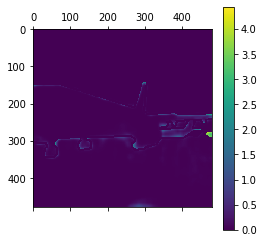

Prediction Label and Attention Map!



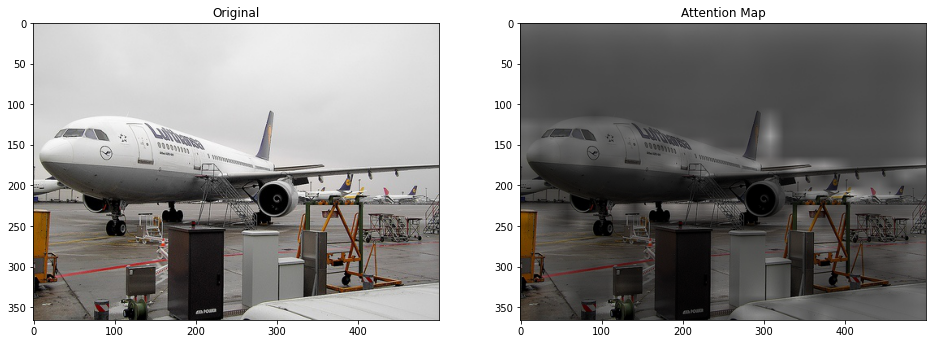

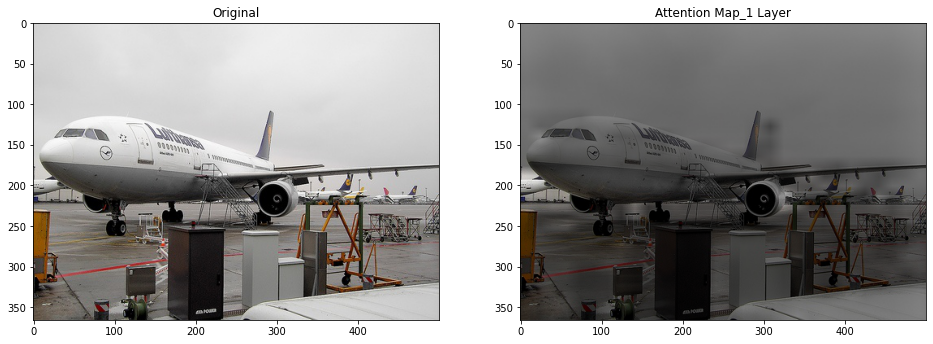

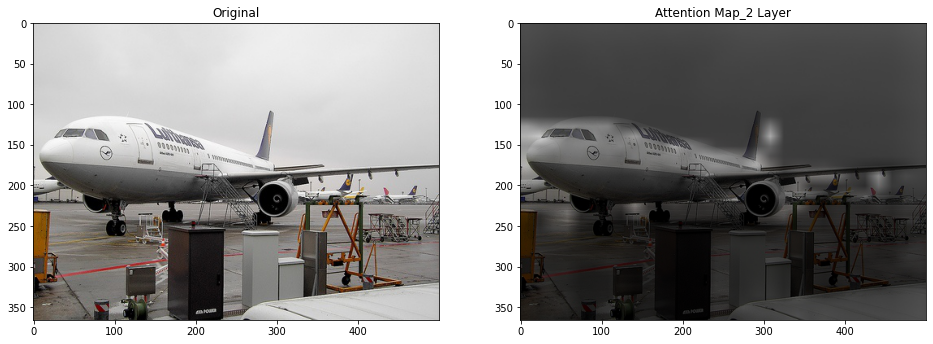

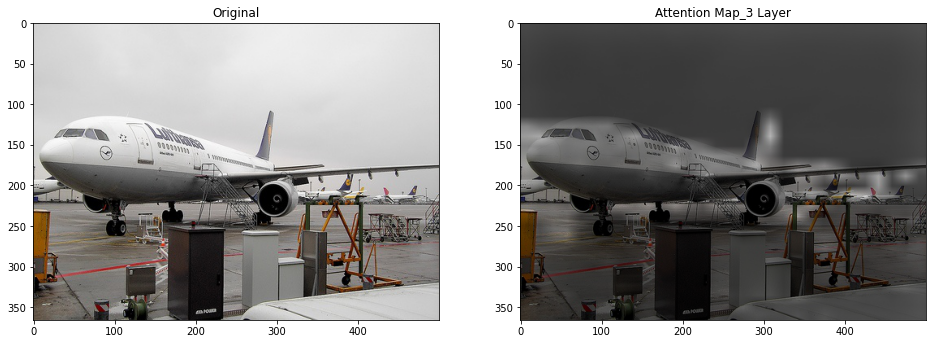

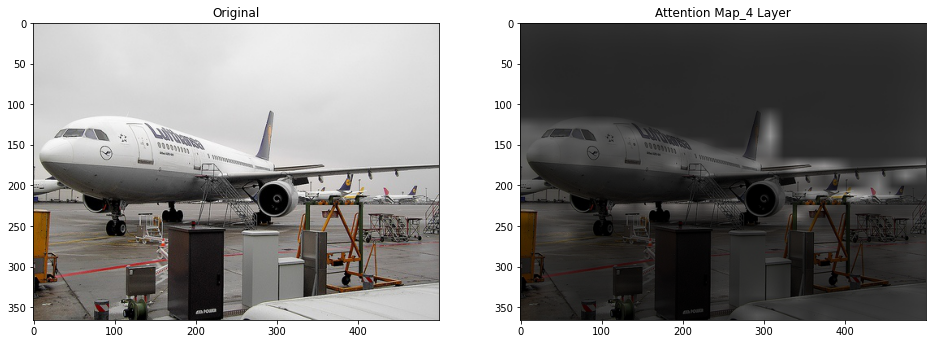

...

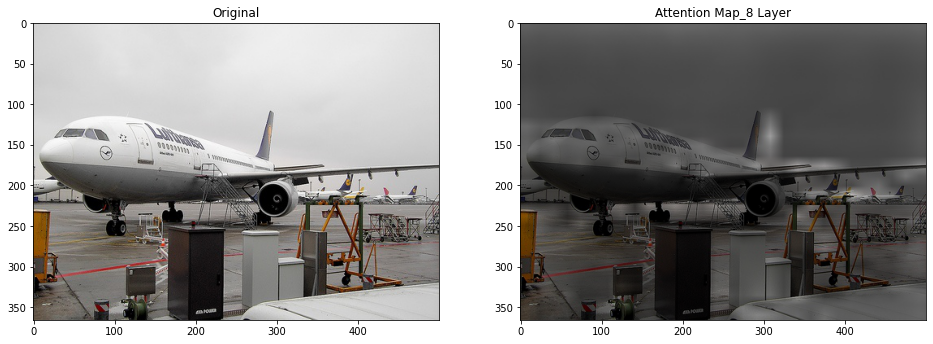

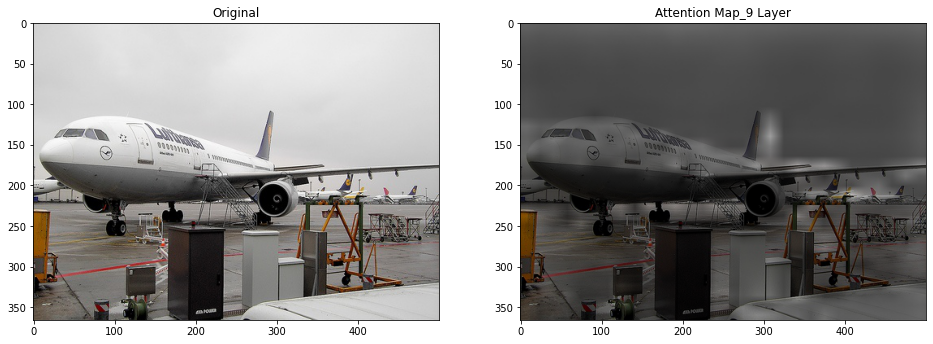

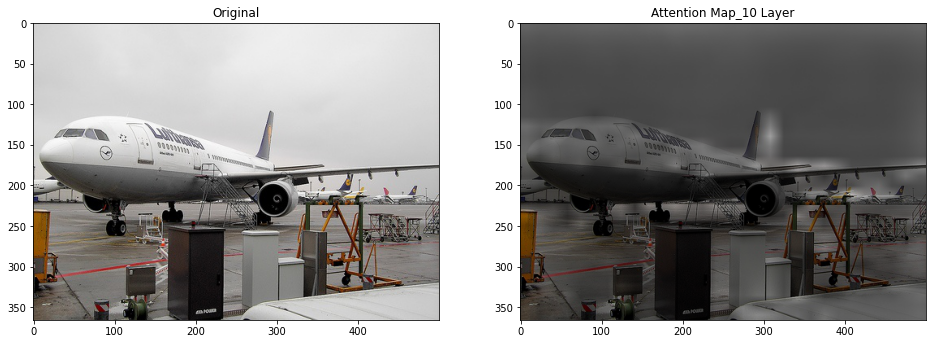

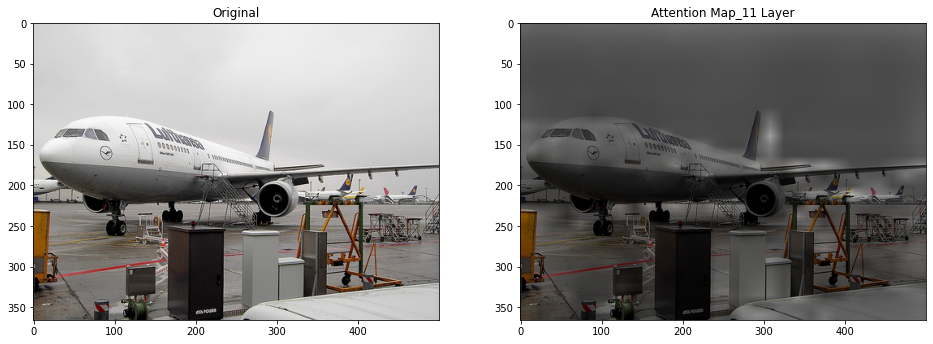

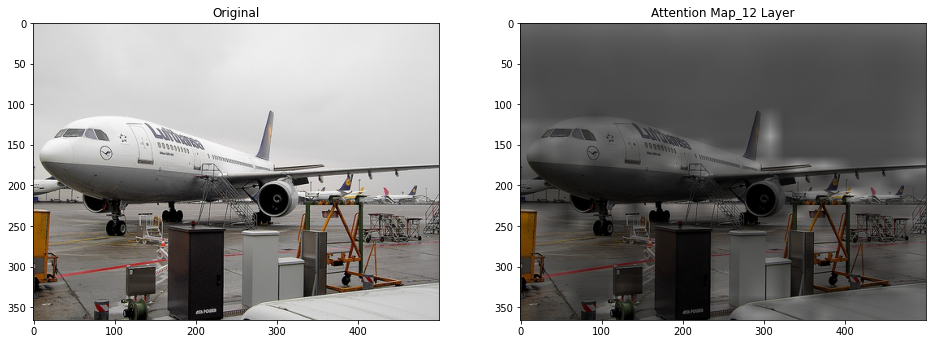

In [8]:
split = "val"
model_data_path = "/workspace/pytorch-segmentation/pro_data/PSPNet_VOC/"
feature_dir = model_data_path + split + "/output/"
image_dir = model_data_path + split + "/image/"
loss_dir = model_data_path + split + "/loss/"
attention_display(0, "2007_000033.jpg")

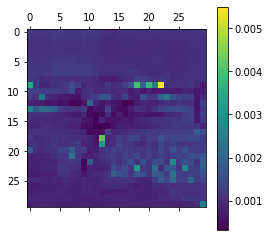

In [17]:
plt.matshow(mask)
plt.colorbar()
plt.show()

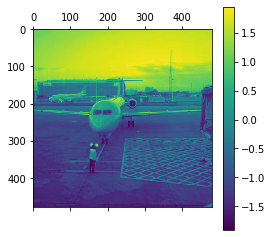

In [18]:
plt.matshow(feature[0])
plt.colorbar()
plt.show()

In [33]:
new_mask = mask/mask.max()
new_mask = np.repeat(np.repeat(new_mask, 16, axis=0), 16, axis=1)

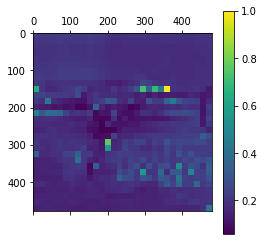

In [34]:
plt.matshow(new_mask)
plt.colorbar()
plt.show()

Prediction Label and Attention Map!



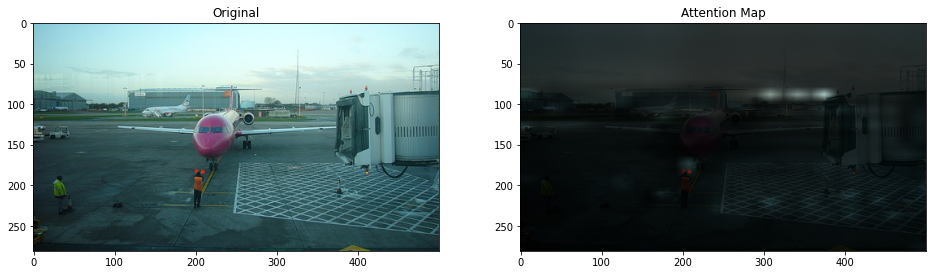

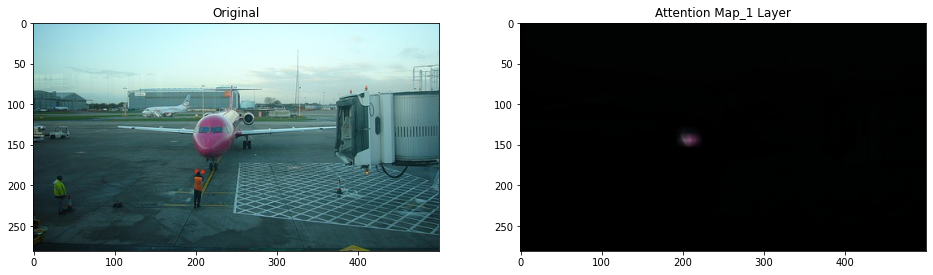

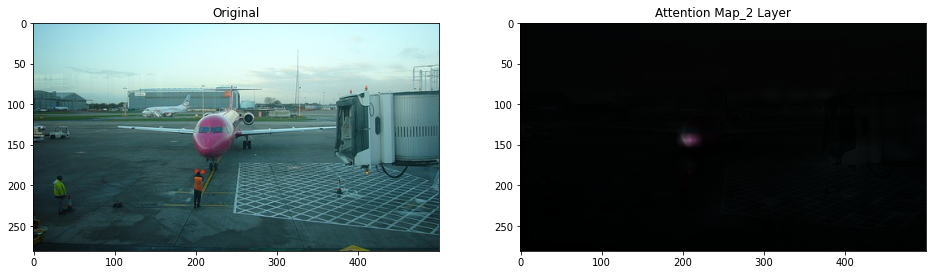

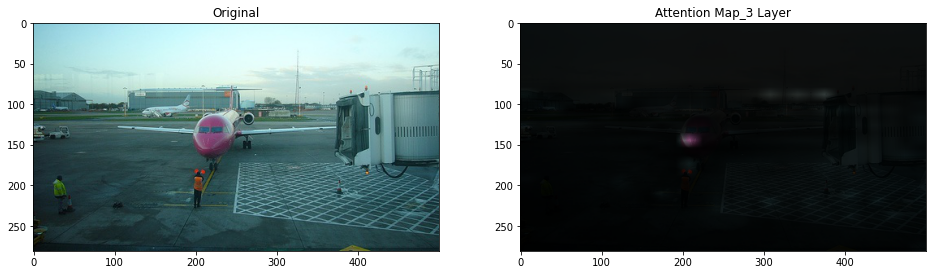

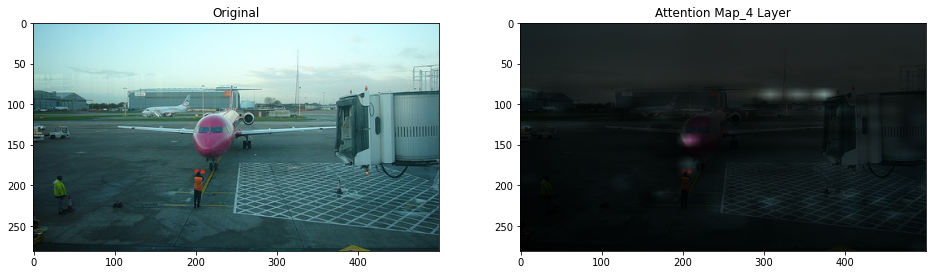

...

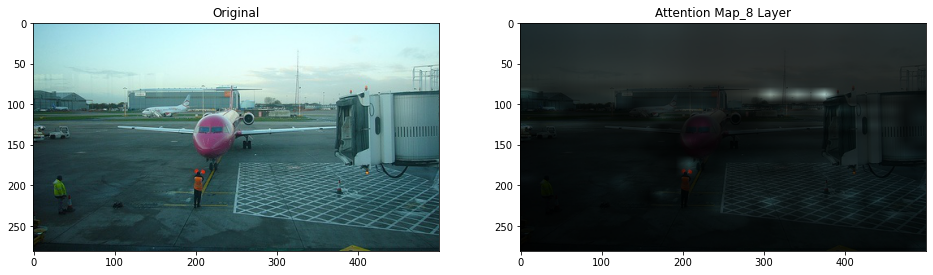

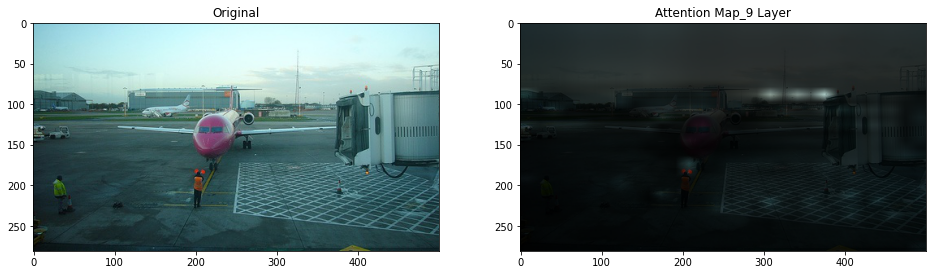

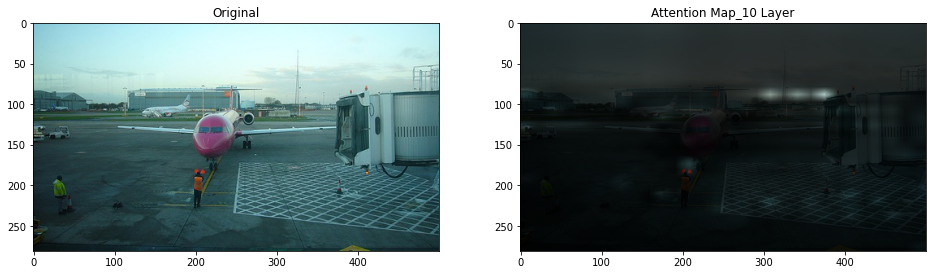

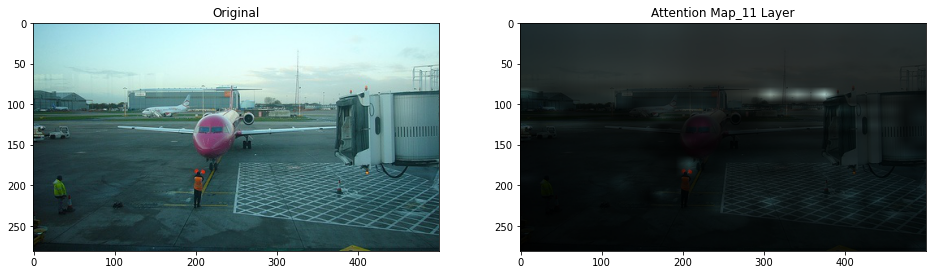

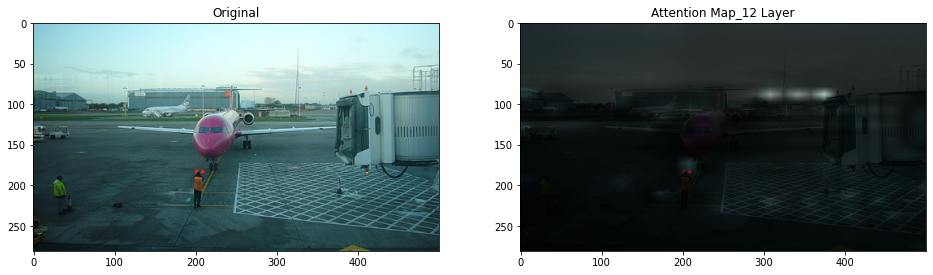